In [94]:
# used to supress display of warnings
import warnings

# os is used to provide a way of using operating system dependent functionality
# We use it for setting working folder
import os

## For all the Image processing activity
import cv2

# Pandas is used for data manipulation and analysis
import pandas as pd 

# Numpy is used for large, multi-dimensional arrays and matrices, along with mathematical operators on these arrays
import numpy as np

# Matplotlib is a data visualization library for 2D plots of arrays, built on NumPy arrays 
# and designed to work with the broader SciPy stack
import matplotlib.pyplot as plt
%matplotlib inline
from matplotlib import pyplot

# Seaborn is based on matplotlib, which aids in drawing attractive and informative statistical graphics.
import seaborn as sns
import tensorflow 
print(tensorflow.__version__)


from keras.utils import np_utils
from keras.models import Sequential
from keras.layers import GlobalAveragePooling2D
from keras.layers.core import Dense, Dropout, Activation, Flatten
from keras.layers.convolutional import Conv2D, MaxPooling2D
from keras.optimizers import SGD
from keras.constraints import maxnorm
from PIL import Image
from PIL import ImageMath

from sklearn.utils import shuffle

# Initialize the random number generator
import random

## train and test Data set split
from sklearn.model_selection import train_test_split

## Doing Onr hot encoding
from tensorflow.keras.utils import to_categorical
import tensorflow as tf

2.5.0


# **1. Import the data. Analyse the dimensions of the data.**

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Setting Options**

In [4]:
# suppress display of warnings
warnings.filterwarnings('ignore')

# display all dataframe columns
pd.options.display.max_columns = None

# display all dataframe rows
pd.options.display.max_rows = None

random.seed(42)

# **We can load the oxflower17 Dataset from tflearn library**

In [7]:
pip install tflearn

In [8]:
import tflearn
import tflearn.datasets.oxflower17 as oxflower17

Instructions for updating:
non-resource variables are not supported in the long term


In [9]:
 X_tflearn,Y_tflearn = oxflower17.load_data()

100.0% 60276736 / 60270631


Succesfully downloaded 17flowers.tgz 60270631 bytes.
File Extracted
Starting to parse images...
Parsing Done!


In [10]:
X_tflearn.shape

(1360, 224, 224, 3)

In [224]:
Y_tflearn[0]

2

# **Loading the images from the Drive with their respective Labels**

In [5]:
os.chdir('/content/drive/MyDrive/Colab Notebooks/17flowers/jpg')

In [6]:
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/17flowers/jpg'

In [60]:
flower_img = []
flower_labels = []

for i in range(0,17):
  flower_i_list = os.listdir('/content/drive/MyDrive/Colab Notebooks/17flowers/jpg/'+str(i))
  for j in flower_i_list:
      img_path = os.path.join('/content/drive/MyDrive/Colab Notebooks/17flowers/jpg/'+str(i),j)
      img = cv2.imread(img_path)
      img = cv2.resize(img,(224,224))
      flower_img.append(img)
      flower_labels.append(i)

In [95]:
## Converting into numpy Array

X_img = np.asarray(flower_img)
Y_labels = np.asarray(flower_labels).reshape(1375,1)

In [96]:
print('Type of X_img - {} '.format(type(X_img)))
print('Type of Y_labels - {} '.format(type(Y_labels)))
print('Shape of X_img - {} '.format(X_img.shape))
print('Shape of Y_labels - {} '.format(Y_labels.shape))

Type of X_img - <class 'numpy.ndarray'> 
Type of Y_labels - <class 'numpy.ndarray'> 
Shape of X_img - (1375, 224, 224, 3) 
Shape of Y_labels - (1375, 1) 


# **Observations:**
 

1.   The Image loaded from Drive has more images on comparing with the images from tflearn library. Hence we will use the images loaded from the Google Drive.


  
     

#**3. Data visualisation:**

# **Display Image**

In [64]:
image = X_img[0]

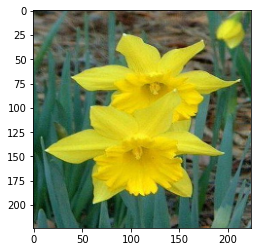

In [65]:
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

# **Display Labels**

In [44]:
print("Label: ", Y_labels[0])

Label:  [0]


# **Display Image vs Labels**

# **Flower Species 0 belongs to Dafodils** 



label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]
label for each of the below image: [0]


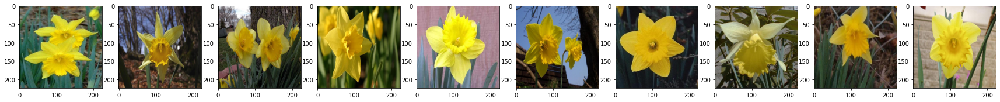

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(10):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 1 belongs to Snow drop** 

label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]
label for each of the below image: [1]


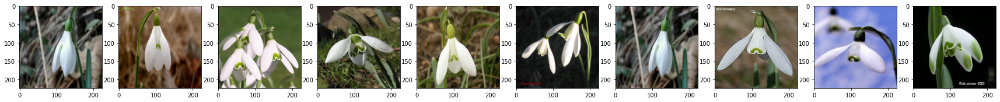

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(90,100):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 2 belongs to Lilly Valley** 

label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]
label for each of the below image: [2]


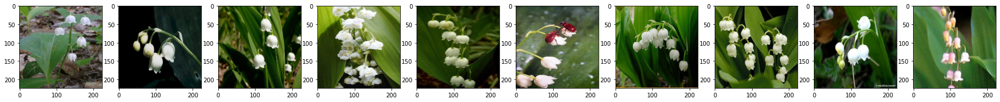

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(170,180):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 3 belongs to Blue Bell**


label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]
label for each of the below image: [3]


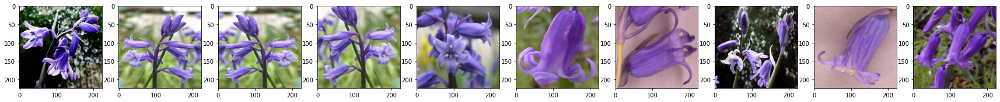

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(240,250):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 4 belongs to Crocus**


label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]
label for each of the below image: [4]


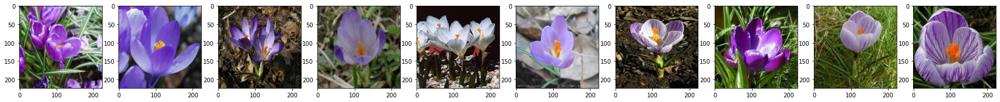

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(320,330):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 5 belongs to Iris**


label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]
label for each of the below image: [5]


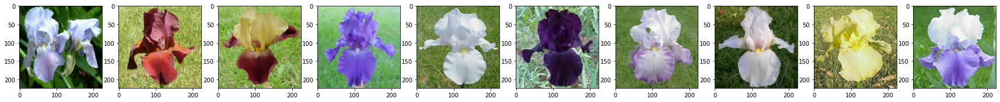

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(400,410):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 6 belongs to TigerLily**

label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]
label for each of the below image: [6]


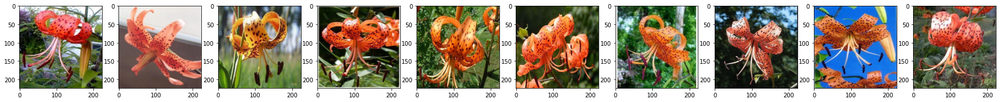

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(480,490):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 7 belongs to Tulip**

label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]
label for each of the below image: [7]


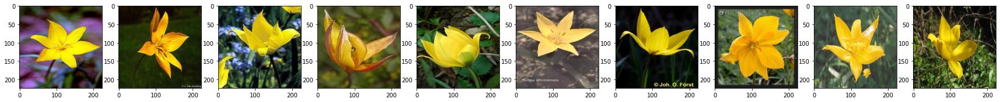

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(560,570):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 8 belongs to Fritillary**

label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]
label for each of the below image: [8]


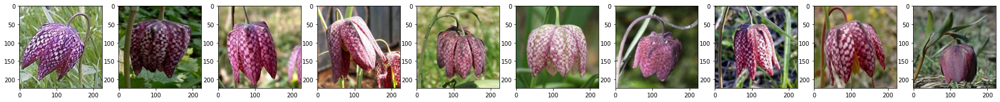

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(640,650):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 9 belongs to Sunflower**

label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]
label for each of the below image: [9]


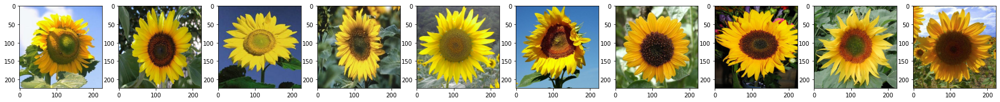

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(720,730):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 10 belongs to Daisy**

label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]
label for each of the below image: [10]


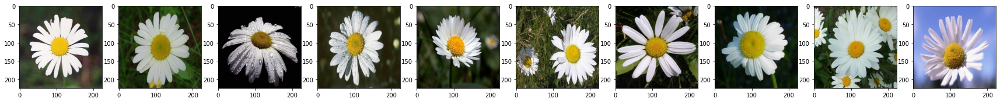

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(800,810):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 11 belongs to Colt's Foot**

label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]
label for each of the below image: [11]


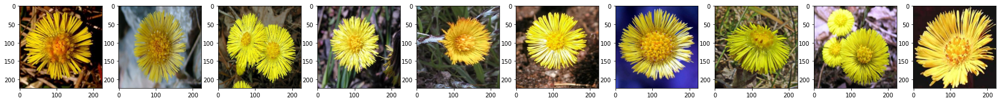

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(880,890):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 12 belongs to Dandelion**

label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]
label for each of the below image: [12]


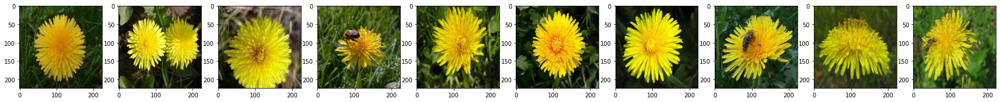

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(970,980):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 13 belongs to cowslip**

label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]
label for each of the below image: [13]


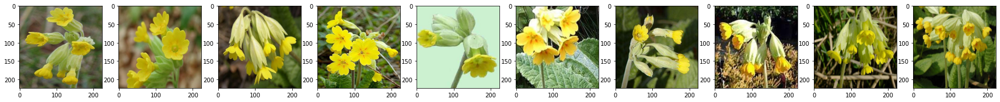

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(1050,1060):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 14 belongs to ButterCup**

label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]
label for each of the below image: [14]


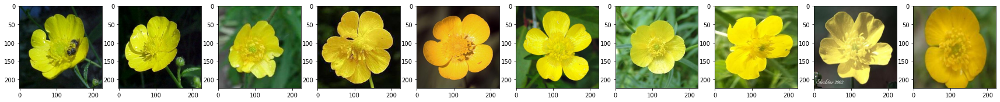

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(1150,1160):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 15 belongs to Wind Flower**

label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]
label for each of the below image: [15]


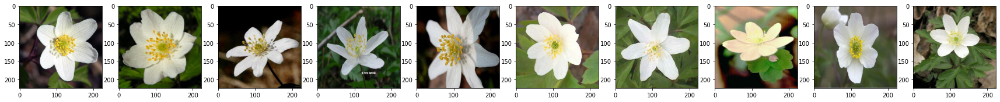

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(1250,1260):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

# **Flower Species 16 belongs to Pansy**

label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]
label for each of the below image: [16]


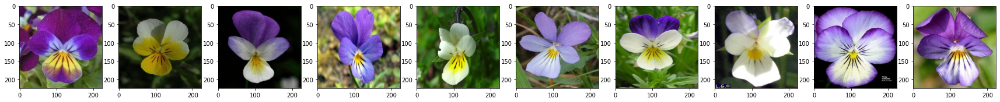

In [ ]:
plt.figure(figsize=(30, 40))
j=0
for i in range(1320,1330):
    j +=1
    plt.subplot(1,10,j)
    plt.imshow(cv2.cvtColor(X_img[i], cv2.COLOR_BGR2RGB))
    print('label for each of the below image: %s' % (Y_labels[i]))
plt.show()

## **Apply different filters [ for example: blur, contour, edge detection, emboss, smooth etc.] on the images and display the image.**




# **Averaging**

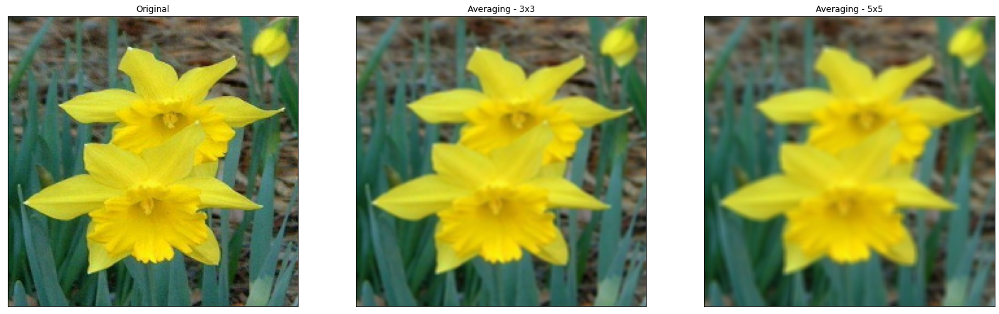

In [66]:

av3 = cv2.blur(image,(3,3))
av5 = cv2.blur(image,(5,5))# Plot the image. This code is excluded for the rest of the article.
plt.gcf().set_size_inches(25,25)
plt.subplot(131),plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)),plt.title('Original')
plt.xticks([]), plt.yticks([])
plt.subplot(132),plt.imshow(cv2.cvtColor(av3, cv2.COLOR_BGR2RGB)),plt.title('Averaging - 3x3')
plt.xticks([]), plt.yticks([])
plt.subplot(133),plt.imshow(cv2.cvtColor(av5, cv2.COLOR_BGR2RGB)),plt.title('Averaging - 5x5')
plt.xticks([]), plt.yticks([])
plt.show()

# **Contours**

Number of Contours found = 87


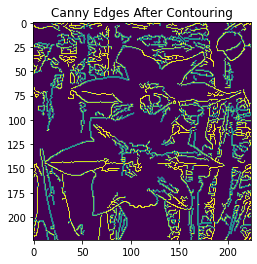

In [67]:
# Grayscale
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  
# Find Canny edges
edged = cv2.Canny(gray, 30, 200)
  
# Finding Contours
# Use a copy of the image e.g. edged.copy()
# since findContours alters the image
contours, hierarchy = cv2.findContours(edged,cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
  
plt.imshow(edged),plt.title('Canny Edges After Contouring')
print("Number of Contours found = " + str(len(contours)))

(<matplotlib.image.AxesImage at 0x7f9c5b7a2e90>, Text(0.5, 1.0, 'Contours'))

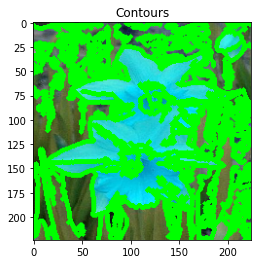

In [68]:
# Draw all contours
# -1 signifies drawing all contours
cv2.drawContours(image, contours, -1, (0, 255, 0), 3)
  
plt.imshow(image),plt.title('Contours')

In [70]:
X_img = np.asarray(flower_img)
image = X_img[0]

In [77]:
type(flower_img)

list

# **Edge Detection**

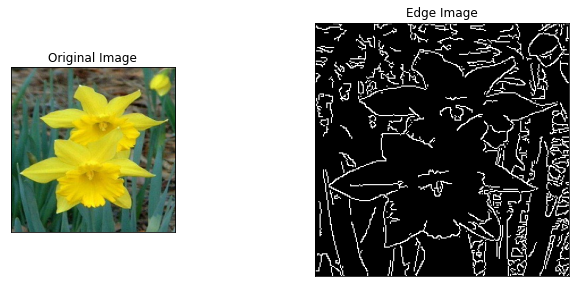

In [74]:
edges = cv.Canny(image,100,200)
plt.gcf().set_size_inches(10,10)
plt.subplot(131),plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image'), plt.xticks([]), plt.yticks([])
plt.subplot(122),plt.imshow(edges,cmap = 'gray')
plt.title('Edge Image'), plt.xticks([]), plt.yticks([])
plt.show()

# **Now we will use PIL package to display the images with different filters like Blur, Contour, Emboss, Edge Detection and Smooth**

# **BLURRING**

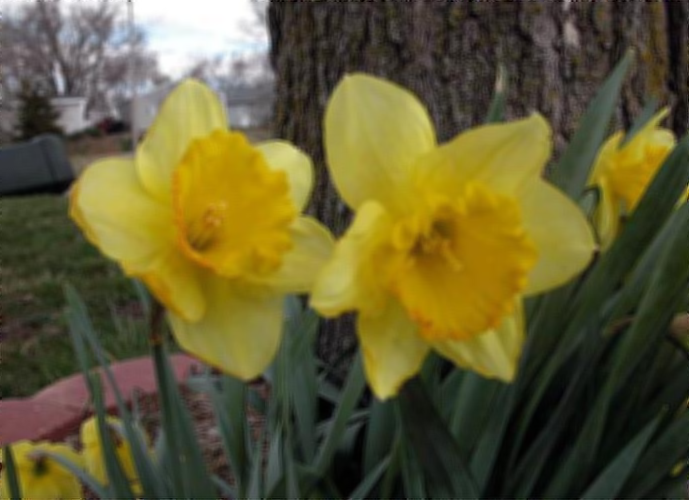

In [86]:
# Importing Image and ImageFilter module from PIL package 
from PIL import Image, ImageFilter
  
im1 = Image.open(r"/content/drive/MyDrive/Colab Notebooks/17flowers/jpg/0/image_0001.jpg")
# applying the blur filter
im2 = im1.filter(ImageFilter.BLUR)
im2

# **CONTOUR**

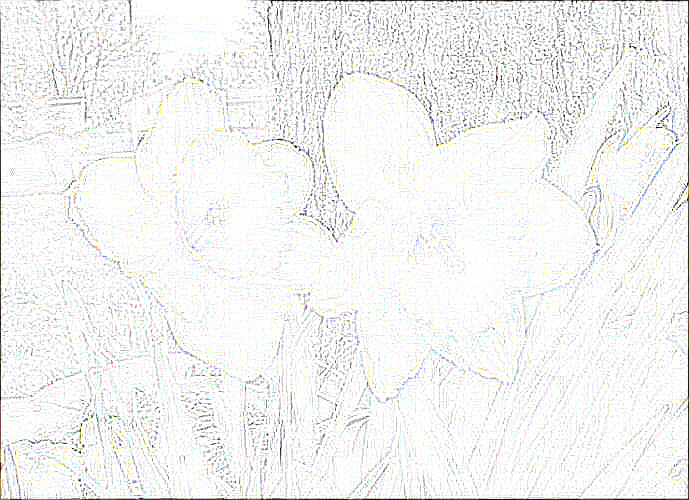

In [87]:
# applying the contour filter
im3 = im1.filter(ImageFilter.CONTOUR)
im3

# **EMBOSS**

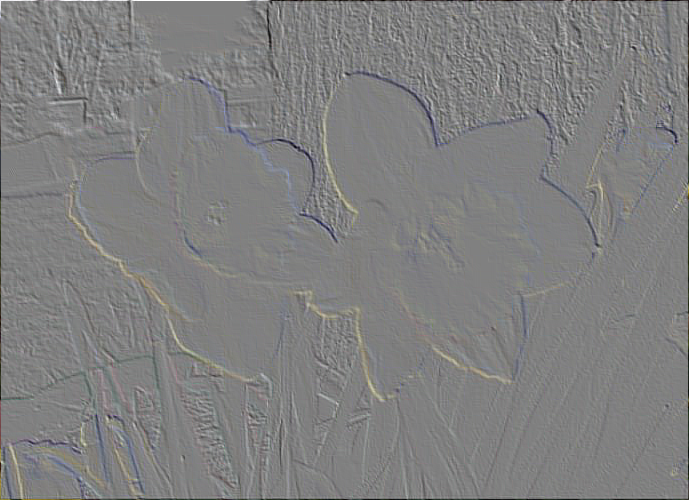

In [88]:
# applying the contour filter
im3 = im1.filter(ImageFilter.EMBOSS)
im3

# **EDGE_ENHANCE**

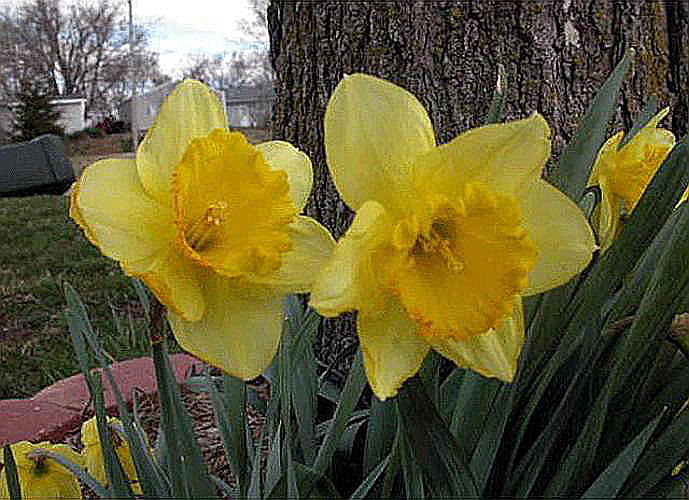

In [89]:
# applying the contour filter
im5 = im1.filter(ImageFilter.EDGE_ENHANCE)
im5

# **EDGES**

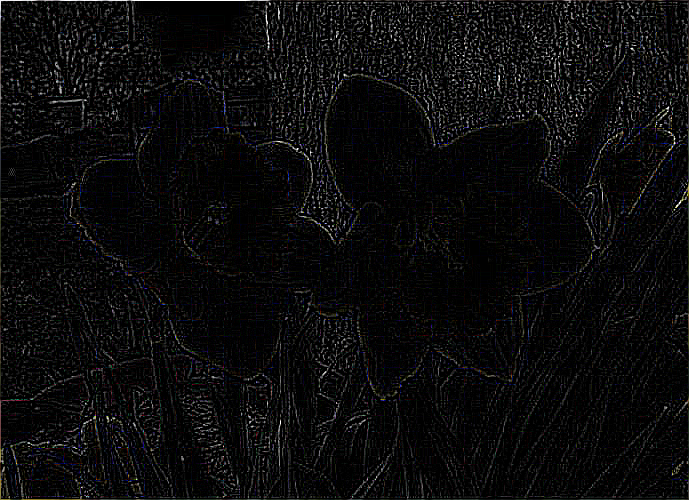

In [90]:
# applying the contour filter
im6 = im1.filter(ImageFilter.FIND_EDGES)
im6

# **SMOOTH**

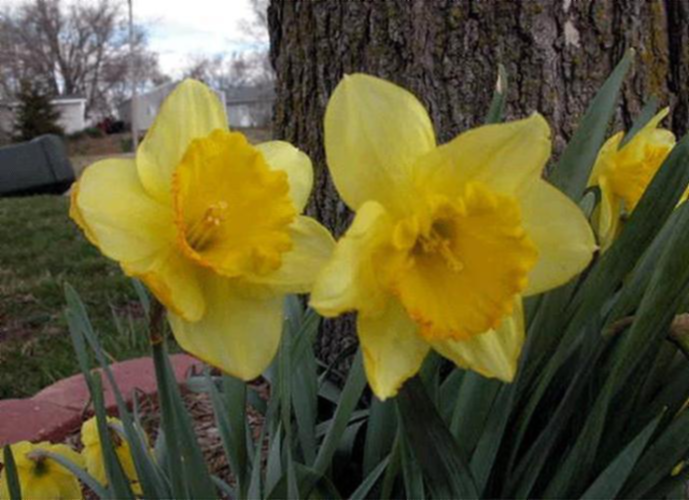

In [91]:
# applying the contour filter
im7 = im1.filter(ImageFilter.SMOOTH)
im7

# **2. Preprocess the data.**

In [97]:
data,labels = shuffle(X_img,Y_labels,random_state=95)

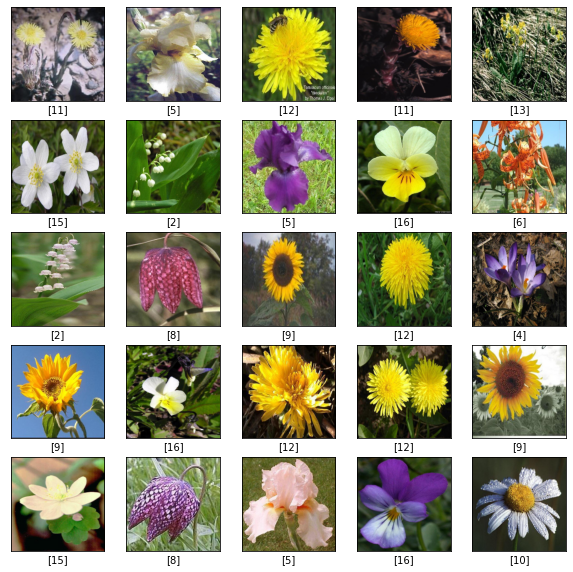

In [98]:
##After Shuffling the image
import matplotlib.pyplot as plt
plt.figure(figsize=(10,10)) # plot 25 images
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(cv2.cvtColor(data[i], cv2.COLOR_BGR2RGB))
    plt.xlabel(labels[i])

In [99]:
# train and Test Split the dataset

X_train,X_test,Y_train,Y_test = train_test_split(data,labels,random_state=20)

In [100]:
print('Shape of X_train is {}'.format(X_train.shape))
print('Shape of X_test is {}'.format(X_test.shape))
print('Shape of Y_train is {}'.format(Y_train.shape))
print('Shape of Y_test is {}'.format(Y_test.shape))

Shape of X_train is (1031, 224, 224, 3)
Shape of X_test is (344, 224, 224, 3)
Shape of Y_train is (1031, 1)
Shape of Y_test is (344, 1)


In [101]:
### Normalize the data by dividing by 255 and converting it as a float

X_train = X_train.astype('float32')
X_test = X_test.astype('float32')

X_train /= 255
X_test /= 255

In [102]:
Y_train = to_categorical(Y_train, num_classes=17)
Y_test = to_categorical(Y_test, num_classes=17)

In [103]:
Y_train[0]

array([0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
      dtype=float32)

# **4. Train tune and test AIML image classifier model using:**

# **Use your own designed CNN for training**

In [92]:
## Using the Own design as similar to VGGNet Architecture 

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPool2D, Flatten, Dense


model = tf.keras.Sequential()

model.add(Conv2D(filters=64, kernel_size=3, activation="relu", input_shape=(224, 224, 3)))
model.add(Conv2D(filters=64, kernel_size=3, activation="relu" ))
model.add(MaxPool2D(2,2))


model.add(Conv2D(filters=128, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=128, kernel_size=3, activation="relu" ))
model.add(MaxPool2D(2,2))



model.add(Conv2D(filters=256, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=256, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=256, kernel_size=3, activation="relu" ))
model.add(MaxPool2D(2,2))



model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(MaxPool2D(2,2))


model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(Conv2D(filters=512, kernel_size=3, activation="relu" ))
model.add(MaxPool2D(2,2))


model.add(Flatten())
model.add(Dense(4096, activation="relu"))
model.add(Dropout(rate=0.5))

model.add(Dense(4096, activation="relu"))
model.add(Dropout(rate=0.5))

model.add(Dense(17, activation="softmax"))

In [106]:
model.summary()

Model: "sequential_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1354 (Conv2D)         (None, 222, 222, 64)      1792      
_________________________________________________________________
conv2d_1355 (Conv2D)         (None, 220, 220, 64)      36928     
_________________________________________________________________
max_pooling2d_71 (MaxPooling (None, 110, 110, 64)      0         
_________________________________________________________________
conv2d_1356 (Conv2D)         (None, 108, 108, 128)     73856     
_________________________________________________________________
conv2d_1357 (Conv2D)         (None, 106, 106, 128)     147584    
_________________________________________________________________
max_pooling2d_72 (MaxPooling (None, 53, 53, 128)       0         
_________________________________________________________________
conv2d_1358 (Conv2D)         (None, 51, 51, 256)     

In [107]:
# Compile the model
model.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer="adam")

In [109]:
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'min')
# Fit the model
history = model.fit( x=X_train, y=Y_train, batch_size=32, epochs=50, validation_split=0.3,callbacks=[callback])

Train on 721 samples, validate on 310 samples
Epoch 1/50
721/721 [==============================] - 107s 149ms/sample - loss: 2.8376 - acc: 0.0527 - val_loss: 2.8396 - val_acc: 0.0548
Epoch 2/50
721/721 [==============================] - 106s 147ms/sample - loss: 2.8348 - acc: 0.0680 - val_loss: 2.8408 - val_acc: 0.0548
Epoch 3/50
721/721 [==============================] - 105s 146ms/sample - loss: 2.8335 - acc: 0.0624 - val_loss: 2.8405 - val_acc: 0.0548
Epoch 4/50
721/721 [==============================] - 107s 149ms/sample - loss: 2.8341 - acc: 0.0680 - val_loss: 2.8433 - val_acc: 0.0548
Epoch 5/50
721/721 [==============================] - 106s 147ms/sample - loss: 2.8340 - acc: 0.0666 - val_loss: 2.8428 - val_acc: 0.0548
Epoch 6/50
721/721 [==============================] - 107s 148ms/sample - loss: 2.8324 - acc: 0.0735 - val_loss: 2.8411 - val_acc: 0.0548
Epoch 7/50
721/721 [==============================] - 105s 146ms/sample - loss: 2.8330 - acc: 0.0707 - val_loss: 2.8406 - val_

In [110]:
score_sample = model.evaluate(X_test, Y_test)
print('Test loss:', score_sample[0])
print('Test accuracy:', score_sample[1])

Test loss: 2.8361837531245033
Test accuracy: 0.034883723


# **Observations:**
 
 -  Created the own design as similar to VGG 16 architecture but the accuracy for training and testing looks to be too low. Prediction using this model will always mislead. 
 -  As the accuracy is too low we don't want to predict any flower species.

In [135]:
## Own Designed CNN
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPool2D, Flatten, Dense


model_2 = tf.keras.Sequential()

model_2.add(Conv2D(filters=32, kernel_size=3, activation="relu", input_shape=(224, 224, 3)))
model_2.add(Conv2D(filters=32, kernel_size=3, activation="relu" ))
model_2.add(MaxPool2D(2,2))


model_2.add(Conv2D(filters=64, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=64, kernel_size=3, activation="relu" ))
model_2.add(MaxPool2D(2,2))



model_2.add(Conv2D(filters=64, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=64, kernel_size=3, activation="relu" ))
model_2.add(MaxPool2D(2,2))


model_2.add(Conv2D(filters=80, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=80, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=80, kernel_size=3, activation="relu" ))
model_2.add(MaxPool2D(2,2))



model_2.add(Conv2D(filters=100, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=100, kernel_size=3, activation="relu" ))
model_2.add(Conv2D(filters=100, kernel_size=3, activation="relu" ))
model_2.add(MaxPool2D(2,2))


model_2.add(Flatten())
model_2.add(Dense(300, activation="relu"))
model_2.add(Dropout(rate=0.25))

model_2.add(Dense(100, activation="relu"))
model_2.add(Dropout(rate=0.25))

model_2.add(Dense(50, activation="relu"))
model_2.add(Dropout(rate=0.25))


model_2.add(Dense(17, activation="softmax"))

In [136]:
model_2.summary()

Model: "sequential_23"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1367 (Conv2D)         (None, 222, 222, 32)      896       
_________________________________________________________________
conv2d_1368 (Conv2D)         (None, 220, 220, 32)      9248      
_________________________________________________________________
max_pooling2d_86 (MaxPooling (None, 110, 110, 32)      0         
_________________________________________________________________
conv2d_1369 (Conv2D)         (None, 108, 108, 64)      18496     
_________________________________________________________________
conv2d_1370 (Conv2D)         (None, 106, 106, 64)      36928     
_________________________________________________________________
max_pooling2d_87 (MaxPooling (None, 53, 53, 64)        0         
_________________________________________________________________
conv2d_1371 (Conv2D)         (None, 51, 51, 64)      

In [137]:
# Compile the model
model_2.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer="rmsprop")

In [138]:
from tensorflow.keras.callbacks import ModelCheckpoint
check_point = ModelCheckpoint('./checkpoint',monitor='val_loss',save_best_only=True,save_freq='epoch')
callback_2 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'min')
# Fit the model 
history_2 = model_2.fit( x=X_train, y=Y_train, batch_size=32, epochs=500, validation_split=0.3,callbacks=[callback_2,check_point])

Train on 721 samples, validate on 310 samples
Epoch 1/500
721/721 [==============================] - 61s 85ms/sample - loss: 3.1947 - acc: 0.0555 - val_loss: 2.8259 - val_acc: 0.0839
Epoch 2/500
721/721 [==============================] - 32s 44ms/sample - loss: 2.8319 - acc: 0.0777 - val_loss: 2.8340 - val_acc: 0.0710
Epoch 3/500
721/721 [==============================] - 32s 44ms/sample - loss: 2.8339 - acc: 0.0624 - val_loss: 2.8336 - val_acc: 0.0548
Epoch 4/500
721/721 [==============================] - 32s 45ms/sample - loss: 2.9412 - acc: 0.0693 - val_loss: 2.8063 - val_acc: 0.1161
Epoch 5/500
721/721 [==============================] - 32s 45ms/sample - loss: 2.8371 - acc: 0.0902 - val_loss: 2.6201 - val_acc: 0.1484
Epoch 6/500
721/721 [==============================] - 32s 45ms/sample - loss: 2.7987 - acc: 0.0888 - val_loss: 2.6107 - val_acc: 0.1613
Epoch 7/500
721/721 [==============================] - 32s 44ms/sample - loss: 2.6616 - acc: 0.1179 - val_loss: 2.6176 - val_acc: 0.

In [140]:
score = model_2.evaluate(X_test, Y_test)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

Test loss: 1.9053332389787185
Test accuracy: 0.31976745


In [ ]:
y_test_pred = np.argmax(model_2.predict(X_test),axis=1)

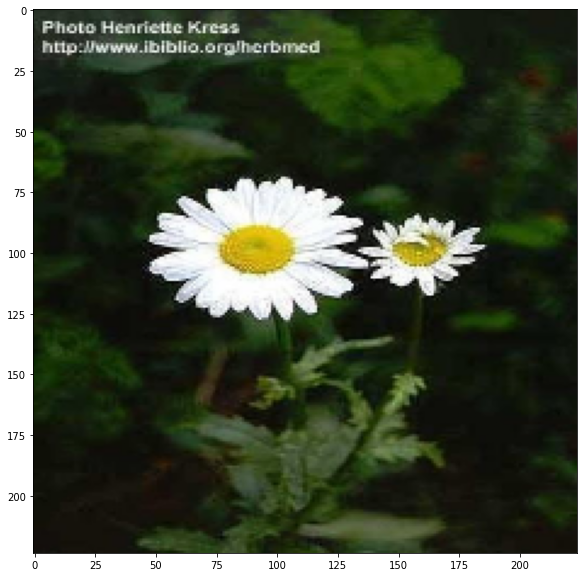

10


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[100], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_2.predict(X_test[100].reshape(1,224,224,3))))

# **Observations:**
- Prediction looks to correct the specis of flower belongs to 10.
- Prediction says the flower species is Daisy

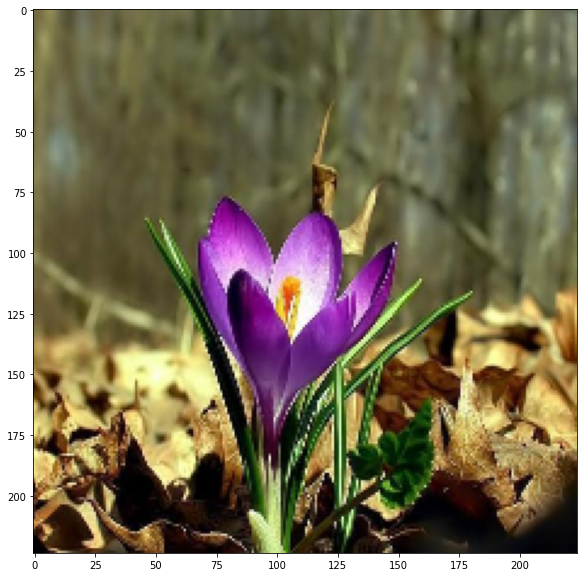

5


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[90], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_2.predict(X_test[90].reshape(1,224,224,3))))

# **Observations:**
- Here the flower species belongs to 4 but the model has predicted wrongly as 5.
- Prediction says the flower species is Iris but actually the species belongs to Crocus

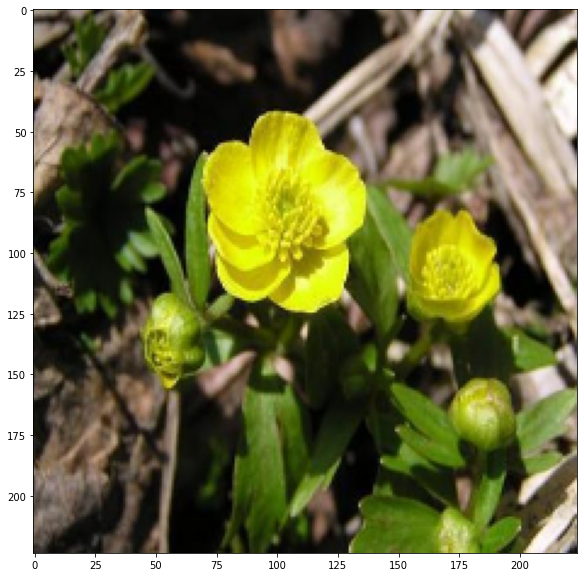

5


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[50], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_2.predict(X_test[50].reshape(1,224,224,3))))

# **Observations:**
- Here the flower species belongs to 14 but the prediction is wrong as species belongs to 5.
- Prediction says the flower species is Iris but the actual species belongs to ButterCup.

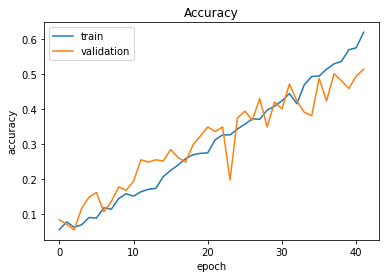

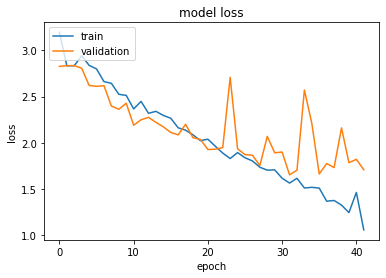

In [141]:
plt.plot(history_2.history['acc'])  
plt.plot(history_2.history['val_acc'])  
plt.title('Accuracy')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_2.history['loss'])  
plt.plot(history_2.history['val_loss'])  
plt.title('model loss')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

# **Observations:**
-  From the above graph we can see the loss gradually decreases but here and there we are seeing the Exploiding gradient problem which makes the model to be underfit with the training accuracy with training accuracy with 61% and Testing accuracy with 31%

- Since the accuracy is low the model cant predict all the test samples successfully.It can predict only few samples correctly.

In [111]:
# use vgg16 pre-trained model with trainable densely connected output layer

#Load the VGG model
vgg_conv = tf.keras.applications.VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze all the layers except for the last layer: 
for layer in vgg_conv.layers[:-4]:
    layer.trainable = False
 
from keras import models
from keras import layers
from keras import optimizers
 
# Create the model
model_3 = tf.keras.Sequential()
 
# Add the vgg convolutional base model
model_3.add(vgg_conv)
 
# Add new layers
model_3.add(layers.Flatten())

model_3.add(Dense(1024, activation="relu"))
model_3.add(Dropout(rate=0.5))
model_3.add(Dense(17, activation="softmax"))
model_3.summary() 

Model: "sequential_20"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg16 (Functional)           (None, 7, 7, 512)         14714688  
_________________________________________________________________
module_wrapper_48 (ModuleWra (None, 25088)             0         
_________________________________________________________________
dense_28 (Dense)             (None, 1024)              25691136  
_________________________________________________________________
dropout_14 (Dropout)         (None, 1024)              0         
_________________________________________________________________
dense_29 (Dense)             (None, 17)                17425     
Total params: 40,423,249
Trainable params: 32,787,985
Non-trainable params: 7,635,264
_________________________________________________________________


In [112]:
# Compile the model
model_3.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer=optimizers.RMSprop(lr=2e-4))

In [113]:
callback_3 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'min')
# Fit the model 
history_3 = model_3.fit( x=X_train, y=Y_train, batch_size=32, epochs=15, validation_split=0.3,callbacks=[callback_3])

Train on 721 samples, validate on 310 samples
Epoch 1/15
721/721 [==============================] - 49s 68ms/sample - loss: 2.7907 - acc: 0.1331 - val_loss: 2.1930 - val_acc: 0.3065
Epoch 2/15
721/721 [==============================] - 43s 59ms/sample - loss: 1.8293 - acc: 0.4175 - val_loss: 2.3427 - val_acc: 0.3452
Epoch 3/15
721/721 [==============================] - 42s 59ms/sample - loss: 1.2050 - acc: 0.6283 - val_loss: 1.2893 - val_acc: 0.5968
Epoch 4/15
721/721 [==============================] - 41s 56ms/sample - loss: 0.7173 - acc: 0.7809 - val_loss: 1.1873 - val_acc: 0.6581
Epoch 5/15
721/721 [==============================] - 39s 54ms/sample - loss: 0.4438 - acc: 0.8544 - val_loss: 1.0351 - val_acc: 0.7032
Epoch 6/15
721/721 [==============================] - 39s 54ms/sample - loss: 0.3932 - acc: 0.8904 - val_loss: 0.8464 - val_acc: 0.7387
Epoch 7/15
721/721 [==============================] - 39s 53ms/sample - loss: 0.2431 - acc: 0.9501 - val_loss: 1.4373 - val_acc: 0.5903
Ep

In [114]:
score_1 = model_3.evaluate(X_test, Y_test)
print('Test loss:', score_1[0])
print('Test accuracy:', score_1[1])

Test loss: 1.027634016303129
Test accuracy: 0.74418604


In [124]:
score_2 = model_3.evaluate(X_train, Y_train)
print('Train loss:', score_2[0])
print('Train accuracy:', score_2[1])

Train loss: 0.3265347809040292
Train accuracy: 0.9224054


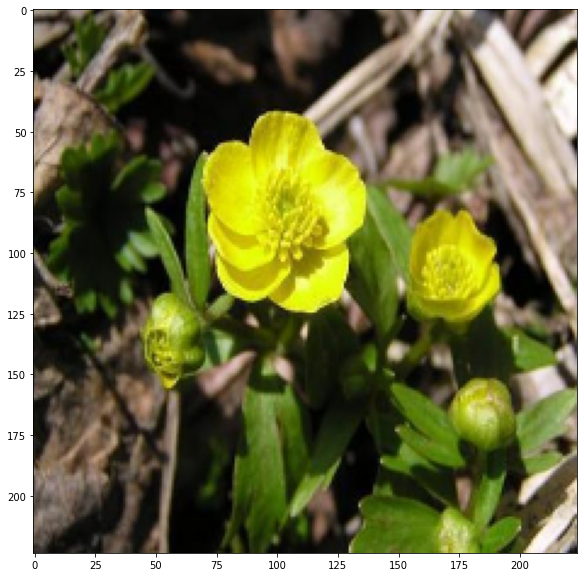

14


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[50], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_3.predict(X_test[50].reshape(1,224,224,3))))

# **Observations:**
- Model predicts correctly as flower species as 14 which means ButterCup

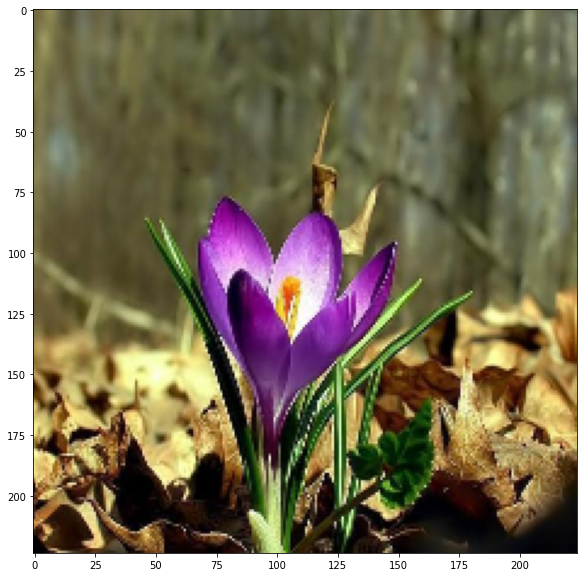

4


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[90], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_3.predict(X_test[90].reshape(1,224,224,3))))

# **Observations:**
- Model predict correctly as the flower species 4 which is Crocus.

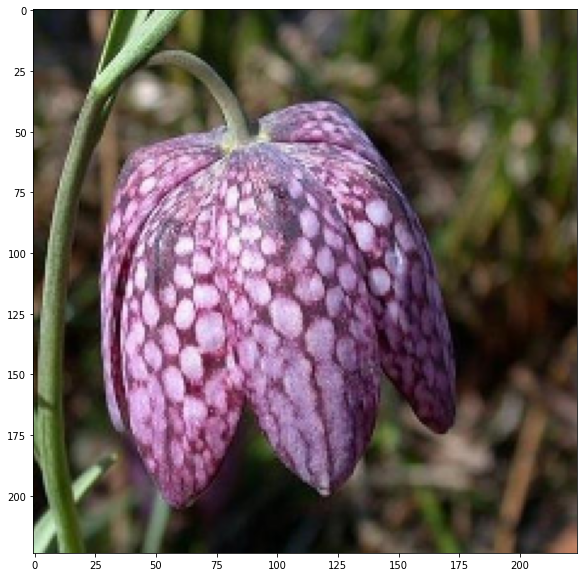

8


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[22], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_3.predict(X_test[22].reshape(1,224,224,3))))

# **Observations:**
- Model predict correclty as Species 8 is of flower Fritillary

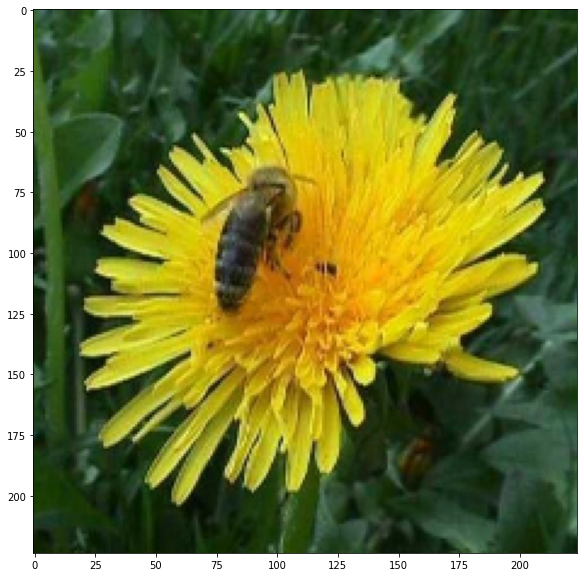

12


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[12], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_3.predict(X_test[12].reshape(1,224,224,3))))

# **Observations:**
- Prediction is correct as Species 12 belongs to Dandelion.

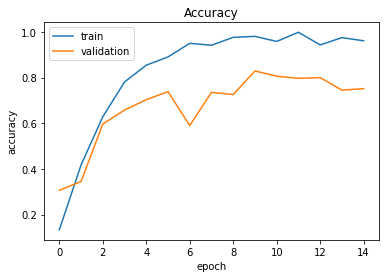

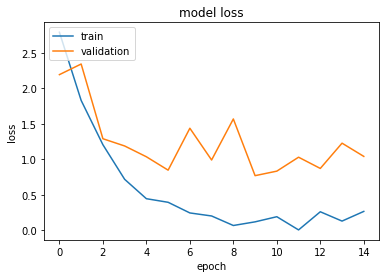

In [129]:
plt.plot(history_3.history['acc'])  
plt.plot(history_3.history['val_acc'])  
plt.title('Accuracy')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_3.history['loss'])  
plt.plot(history_3.history['val_loss'])  
plt.title('model loss')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

# **Observations:**
-  From the above graph we can see the loss gradually decreases but here and there we are seeing the Exploiding gradient problem but since we applied transfer learning the accuracy has been increased, training accuracy is 96% and test accuracy is 74%.

- Since the accuracy is high the prediction on the test samples looks to be accurate. The tranfer learning model based on VGG 16 net is a good model.

In [105]:
# use vgg19 pre-trained model with trainable densely connected output layer
from keras import models
from keras import layers
from keras import optimizers

#Load the VGG model
vgg_conv = tf.keras.applications.VGG19(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

# Freeze all the layers except for the last layer: 
for layer in vgg_conv.layers[:-4]:
    layer.trainable = False

 
# Create the model
model_4 = tf.keras.Sequential()
 
# Add the vgg convolutional base model
model_4.add(vgg_conv)
 
# Add new layers
model_4.add(layers.Flatten())

model_4.add(Dense(1024, activation="relu"))
model_4.add(Dropout(rate=0.5))
model_4.add(Dense(17, activation="softmax"))
model_4.summary() 

Model: "sequential_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Functional)           (None, 7, 7, 512)         20024384  
_________________________________________________________________
module_wrapper (ModuleWrappe (None, 25088)             0         
_________________________________________________________________
module_wrapper_1 (ModuleWrap (None, 1024)              25691136  
_________________________________________________________________
module_wrapper_2 (ModuleWrap (None, 1024)              0         
_________________________________________________________________
module_wrapper_3 (ModuleWrap (None, 17)                17425     
Total params: 45,732,945
Trainable params: 32,787,985
Non-trainable params: 12,944,960
_________________________________________________________________


In [106]:
# Compile the model
model_4.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer=optimizers.RMSprop(lr=2e-4))

In [107]:
callback_4 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'min')
# Fit the model 
history_4 = model_4.fit( x=X_train, y=Y_train, batch_size=32, epochs=10, validation_split=0.3,callbacks=[callback_4])

Epoch 1/10
23/23 [==============================] - 44s 2s/step - loss: 2.7483 - accuracy: 0.1720 - val_loss: 2.1822 - val_accuracy: 0.3323
Epoch 2/10
23/23 [==============================] - 43s 2s/step - loss: 1.7430 - accuracy: 0.4521 - val_loss: 1.6825 - val_accuracy: 0.4484
Epoch 3/10
23/23 [==============================] - 43s 2s/step - loss: 1.1925 - accuracy: 0.6255 - val_loss: 1.1686 - val_accuracy: 0.6548
Epoch 4/10
23/23 [==============================] - 43s 2s/step - loss: 0.6610 - accuracy: 0.7822 - val_loss: 1.0317 - val_accuracy: 0.7032
Epoch 5/10
23/23 [==============================] - 44s 2s/step - loss: 0.4031 - accuracy: 0.8682 - val_loss: 1.2061 - val_accuracy: 0.6484
Epoch 6/10
23/23 [==============================] - 44s 2s/step - loss: 0.2653 - accuracy: 0.9237 - val_loss: 0.7475 - val_accuracy: 0.7871
Epoch 7/10
23/23 [==============================] - 43s 2s/step - loss: 0.1772 - accuracy: 0.9584 - val_loss: 1.1424 - val_accuracy: 0.7355
Epoch 8/10
23/23 [==

In [108]:
score_3 = model_4.evaluate(X_test, Y_test)
print('Test loss:', score_3[0])
print('Test accuracy:', score_3[1])

11/11 [==============================] - 12s 1s/step - loss: 0.7576 - accuracy: 0.8547
Test loss: 0.7575899362564087
Test accuracy: 0.854651153087616


In [ ]:
score_4 = model_4.evaluate(X_train, Y_train)
print('Train loss:', score_4[0])
print('Train accuracy:', score_4[1])

Train loss: 0.3142029725434473
Train accuracy: 0.9379243


In [ ]:
y_test_pred_4 = np.argmax(model_4.predict(X_test),axis=1)

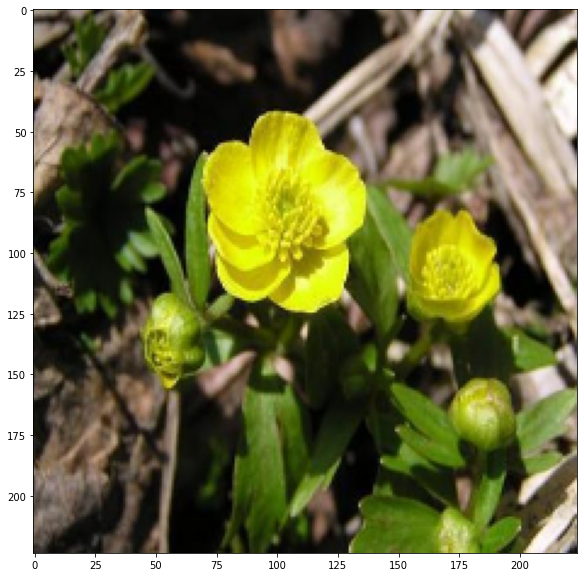

14


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[50], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_4.predict(X_test[50].reshape(1,224,224,3))))

# **Observations:**
- Model predicted correct with the label 14 which is a ButterCup.

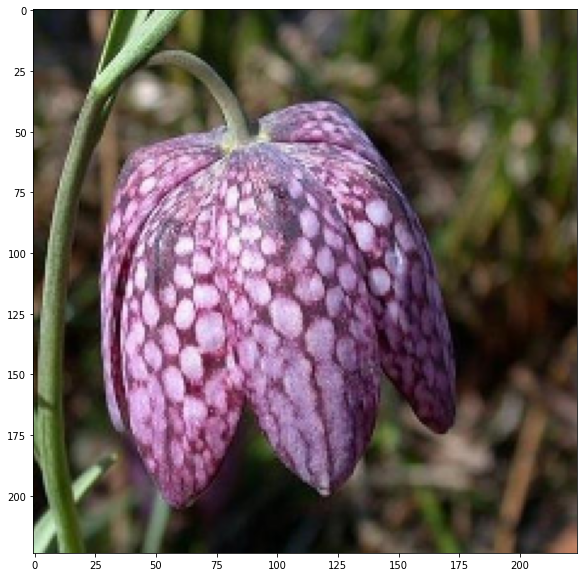

8


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[22], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_4.predict(X_test[22].reshape(1,224,224,3))))

# **Observations:**
- Model predicted correct with the label 8 which is a Fritillary.

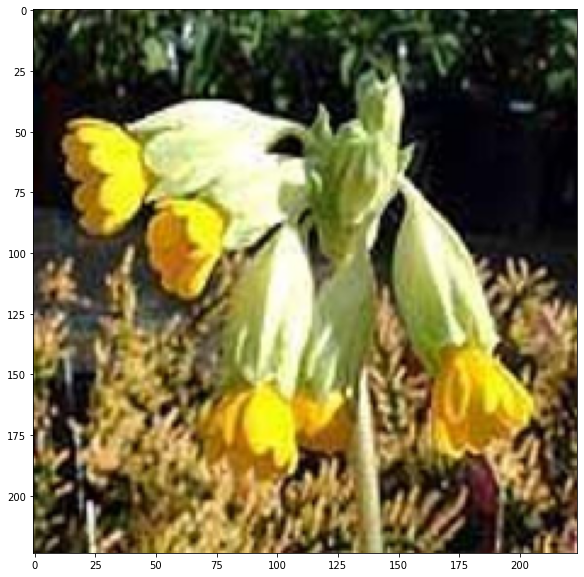

13


In [ ]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[11], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_4.predict(X_test[11].reshape(1,224,224,3))))

# **Observations:**
- Model predicted correct with the label 13 which is a cowslip.

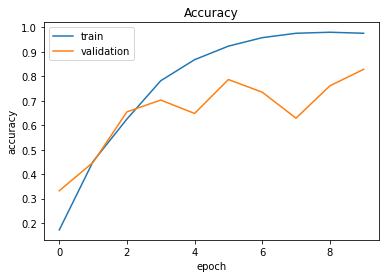

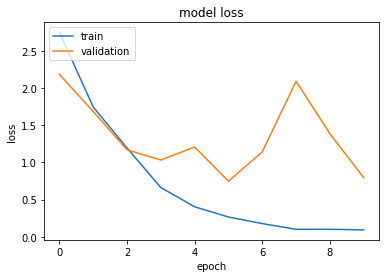

In [110]:
plt.plot(history_4.history['accuracy'])  
plt.plot(history_4.history['val_accuracy'])  
plt.title('Accuracy')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_4.history['loss'])  
plt.plot(history_4.history['val_loss'])  
plt.title('model loss')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

# **Observations:**
-  From the above graph we can see the loss gradually decreases but there is  Exploiding gradient problem but since we applied transfer learning the accuracy has been increased, training accuracy is 97% and test accuracy is 85%.

- Since the accuracy is high the prediction on the test samples looks to be accurate. The tranfer learning model based on VGG 19 net is a good model.

In [173]:
# use InceptionV3 pre-trained model with trainable densely connected output layer

#Load the InceptionV3 model
InceptionV3_conv = tf.keras.applications.InceptionV3(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

InceptionV3_conv.trainable = False

# Create the model
model_5 = tf.keras.Sequential()
# Add the InceptionV3 convolutional base model
model_5.add(InceptionV3_conv)
model_5.add(GlobalAveragePooling2D())
model_5.add(Dropout(0.5))

 
# Add new layers
model_5.add(layers.Flatten())
#Initializer = tf.keras.initializers.he_uniform()
model_5.add(Dense(1024, activation="relu"))
model_5.add(Dropout(rate=0.5))
model_5.add(Dense(17, activation="softmax"))
model_5.summary()

Model: "sequential_26"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Functional)    (None, 5, 5, 2048)        21802784  
_________________________________________________________________
module_wrapper_92 (ModuleWra (None, 2048)              0         
_________________________________________________________________
dropout_21 (Dropout)         (None, 2048)              0         
_________________________________________________________________
module_wrapper_93 (ModuleWra (None, 2048)              0         
_________________________________________________________________
dense_38 (Dense)             (None, 1024)              2098176   
_________________________________________________________________
dropout_22 (Dropout)         (None, 1024)              0         
_________________________________________________________________
dense_39 (Dense)             (None, 17)              

In [174]:
# Compile the model
model_5.compile(loss="categorical_crossentropy", metrics=["accuracy"], optimizer=optimizers.RMSprop(lr=2e-4))

In [149]:
callback_5 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'max')
# Fit the model 
history_5 = model_5.fit( x=X_train, y=Y_train, batch_size=32, epochs=10, validation_data=(X_test,Y_test),callbacks=[callback_5])

Train on 1031 samples, validate on 344 samples
Epoch 1/10
1031/1031 [==============================] - 27s 27ms/sample - loss: 2.8203 - acc: 0.1455 - val_loss: 2.5709 - val_acc: 0.1512
Epoch 2/10
1031/1031 [==============================] - 16s 16ms/sample - loss: 2.2179 - acc: 0.3317 - val_loss: 2.0565 - val_acc: 0.3488
Epoch 3/10
1031/1031 [==============================] - 17s 16ms/sample - loss: 1.8268 - acc: 0.4394 - val_loss: 2.2393 - val_acc: 0.2733
Epoch 4/10
1031/1031 [==============================] - 16s 16ms/sample - loss: 1.5267 - acc: 0.5509 - val_loss: 2.5458 - val_acc: 0.3256
Epoch 5/10
1031/1031 [==============================] - 17s 16ms/sample - loss: 1.3025 - acc: 0.6178 - val_loss: 2.8977 - val_acc: 0.2849
Epoch 6/10
1031/1031 [==============================] - 17s 16ms/sample - loss: 1.1452 - acc: 0.6663 - val_loss: 2.6172 - val_acc: 0.3227
Epoch 7/10
1031/1031 [==============================] - 16s 16ms/sample - loss: 1.0343 - acc: 0.7061 - val_loss: 2.6327 - val

In [150]:
score_5 = model_5.evaluate(X_test, Y_test)
print('Test loss:', score_5[0])
print('Test accuracy:', score_5[1])

Test loss: 2.847880402276682
Test accuracy: 0.37790698


**The above accuracy using the Google net has been low on compare with VGG16 and VGG 19, hence in the cell below I use ImageDataGenerator to modify the training and validation data. I rescale pixel values and normalize them. I also use data augmentation techniques such as rotation, zoom, shifting and flipping on the training data to increase my training dataset size and thus, improve model accuracy.**

In [175]:
from keras.preprocessing.image import ImageDataGenerator
train_datagen = ImageDataGenerator (rescale=1./255,
                                    featurewise_std_normalization=True,
                                    zoom_range=0.2, 
                                    rotation_range=90,
                                    width_shift_range=0.2, 
                                    height_shift_range=0.2, 
                                    horizontal_flip=True, 
                                    fill_mode='nearest')

val_datagen = ImageDataGenerator (rescale=1./255, featurewise_std_normalization=True)

train_generator = train_datagen.flow(X_train, Y_train, batch_size=32)
test_generator = val_datagen.flow(X_test, Y_test, batch_size=32)

In [176]:
model_5.compile(
    optimizer=tf.keras.optimizers.Adam(epsilon=0.00001),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [180]:
callback_6 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'max')
history_6 = model_5.fit_generator(
    train_generator,
    validation_data=test_generator,
    epochs=100,callbacks=[callback_6]
)

Epoch 1/100
33/33 [==============================] - 21s 637ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.4319 - acc: 0.8729 - val_loss: 3.4491 - val_acc: 0.0640
Epoch 2/100
33/33 [==============================] - 19s 577ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.4010 - acc: 0.8720 - val_loss: 3.6699 - val_acc: 0.0640
Epoch 3/100
33/33 [==============================] - 19s 585ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.4721 - acc: 0.8487 - val_loss: 3.4537 - val_acc: 0.0640
Epoch 4/100
33/33 [==============================] - 19s 583ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.5037 - acc: 0.8535 - val_loss: 3.6077 - val_acc: 0.0640
Epoch 5/100
33/33 [==============================] - 19s 578ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.4140 - acc: 0.8681 - val_loss: 3.5218 - val_acc: 0.0640
Epoch 6/100
33/33 [==============================] - 19s 584ms/step - batch: 16.0000 - size: 31.2424 - loss: 0.4621 - acc: 0.8497 - val_loss: 3.7256 - val_acc: 0.075

In [181]:
score_6 = model_5.evaluate(X_test, Y_test)
print('Test loss:', score_6[0])
print('Test accuracy:', score_6[1])

Test loss: 2.715487369271212
Test accuracy: 0.5116279


In [159]:
y_test_pred_5 = np.argmax(model_5.predict(X_test),axis=1)

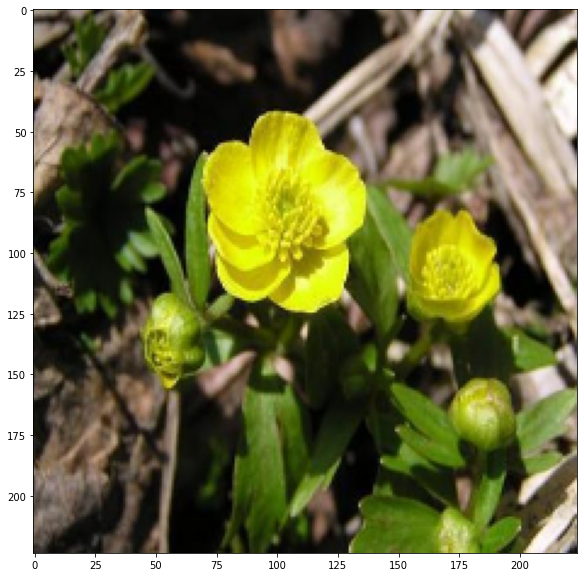

14


In [160]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[50], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_5.predict(X_test[50].reshape(1,224,224,3))))

# **Observations:**
  - Model predicted correct with the label 14 which is a ButterCup.


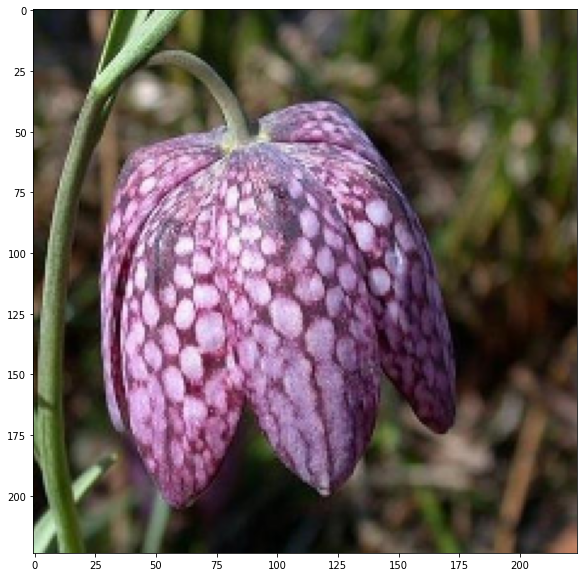

8


In [161]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[22], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_5.predict(X_test[22].reshape(1,224,224,3))))

# **Observations:**
- Model predicted correct with the label 8 which is a Fritillary.


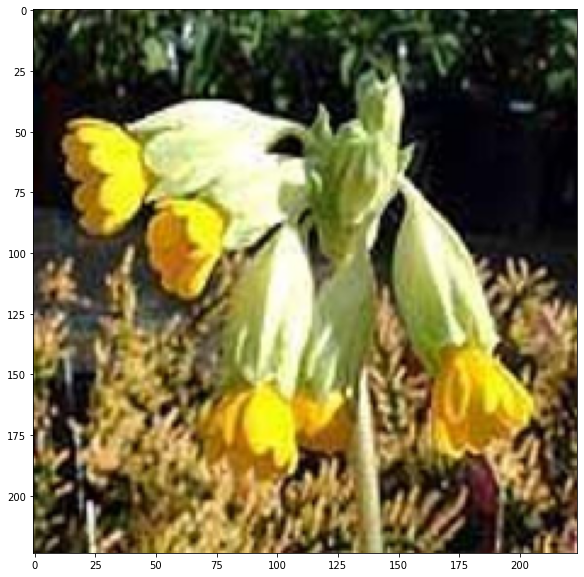

0


In [162]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[11], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_5.predict(X_test[11].reshape(1,224,224,3))))

# **Observations:**
- Model predicted correct with the label 0 which is actually Cowslip. As the accuracy looks to be low prediction went wrong.


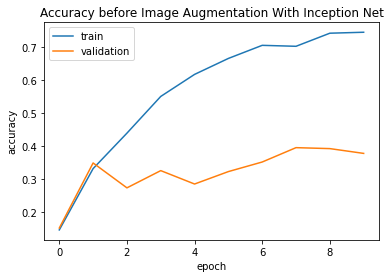

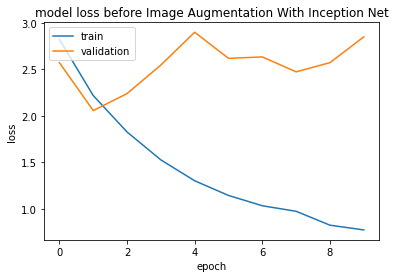

In [182]:
plt.plot(history_5.history['acc'])  
plt.plot(history_5.history['val_acc'])  
plt.title('Accuracy before Image Augmentation With Inception Net')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_5.history['loss'])  
plt.plot(history_5.history['val_loss'])  
plt.title('model loss before Image Augmentation With Inception Net')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

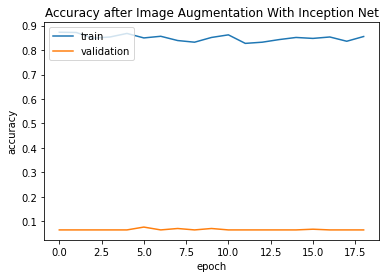

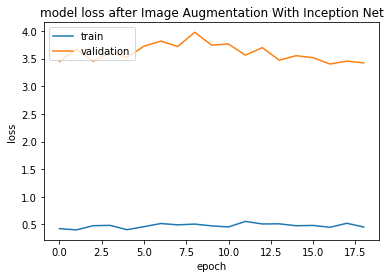

In [183]:
plt.plot(history_6.history['acc'])  
plt.plot(history_6.history['val_acc'])  
plt.title('Accuracy after Image Augmentation With Inception Net')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_6.history['loss'])  
plt.plot(history_6.history['val_loss'])  
plt.title('model loss after Image Augmentation With Inception Net')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

# **Observations:**

- Here we have tried the Google Inception net with 2 ways before Image Augmentation and after Image Augmentation. We can see before Data Augmentation the training accuracy is low, but there is a huge gap between the validation accuracy and training accuracy. This shows that the number of samples for training and validation is not of sufficient size.

- After image augmentation the Training accuracy has increased but the validation accuracy is too low which is due to the Image augmentation applied on the insufficient data sets.


In [205]:
## Using RESNET50
resnet_model = tf.keras.applications.ResNet50(
    include_top=True,
    weights="imagenet",input_shape =(224, 224, 3)
)

resnet_model.trainable = False

# Create the model
model_6 = tf.keras.Sequential()
# Add the Resnet convolutional base model
model_6.add(resnet_model)

# Add new layers
model_6.add(layers.Flatten())
#Initializer = tf.keras.initializers.he_uniform()
model_6.add(Dense(300, activation="relu"))
model_6.add(Dense(100, activation="relu"))
model_6.add(Dropout(rate=0.5))
model_6.add(Dense(17, activation="softmax"))
model_6.summary()

Model: "sequential_31"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
resnet50 (Functional)        (None, 1000)              25636712  
_________________________________________________________________
module_wrapper_98 (ModuleWra (None, 1000)              0         
_________________________________________________________________
dense_50 (Dense)             (None, 300)               300300    
_________________________________________________________________
dense_51 (Dense)             (None, 100)               30100     
_________________________________________________________________
dropout_27 (Dropout)         (None, 100)               0         
_________________________________________________________________
dense_52 (Dense)             (None, 17)                1717      
Total params: 25,968,829
Trainable params: 332,117
Non-trainable params: 25,636,712
___________________________________

In [206]:
model_6.compile(
    optimizer="adam",
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

In [207]:
callback_7 = tf.keras.callbacks.EarlyStopping(monitor='val_loss',patience = 10,restore_best_weights=True,mode = 'min')
# Fit the model 
history_7 = model_6.fit( x=X_train, y=Y_train, batch_size=32, epochs=30, validation_split=0.3,callbacks=[callback_7])

Train on 721 samples, validate on 310 samples
Epoch 1/30
721/721 [==============================] - 33s 45ms/sample - loss: 2.8267 - acc: 0.1040 - val_loss: 2.8344 - val_acc: 0.0355
Epoch 2/30
721/721 [==============================] - 21s 28ms/sample - loss: 2.7920 - acc: 0.2164 - val_loss: 2.8338 - val_acc: 0.0677
Epoch 3/30
721/721 [==============================] - 20s 28ms/sample - loss: 2.7209 - acc: 0.3370 - val_loss: 2.8340 - val_acc: 0.0677
Epoch 4/30
721/721 [==============================] - 20s 28ms/sample - loss: 2.6002 - acc: 0.3440 - val_loss: 2.8372 - val_acc: 0.0677
Epoch 5/30
721/721 [==============================] - 20s 27ms/sample - loss: 2.4165 - acc: 0.3828 - val_loss: 2.8495 - val_acc: 0.0677
Epoch 6/30
721/721 [==============================] - 20s 28ms/sample - loss: 2.1944 - acc: 0.4632 - val_loss: 2.8680 - val_acc: 0.0677
Epoch 7/30
721/721 [==============================] - 20s 27ms/sample - loss: 1.9884 - acc: 0.4896 - val_loss: 2.8721 - val_acc: 0.0677
Ep

In [208]:
score_7 = model_6.evaluate(X_test, Y_test)
print('Test loss:', score_7[0])
print('Test accuracy:', score_7[1])

Test loss: 2.839253597481306
Test accuracy: 0.04360465


In [192]:
y_test_pred_6 = np.argmax(model_6.predict(X_test),axis=1)

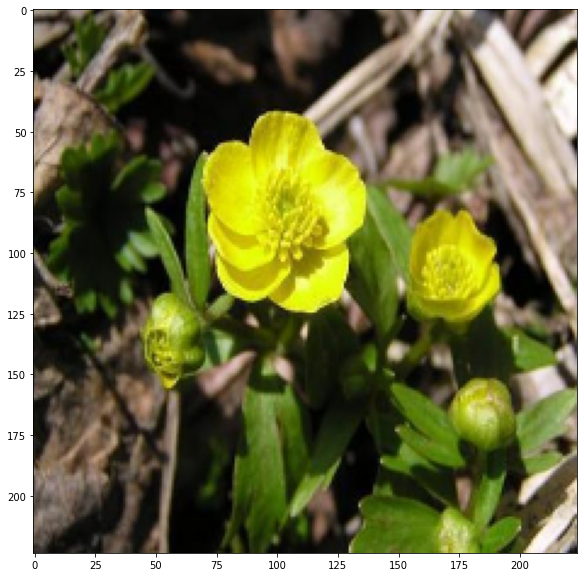

2


In [193]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[50], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_6.predict(X_test[50].reshape(1,224,224,3))))

# **Observations:**
-  Model predict the label as 2 which the flower species is ButterCups.

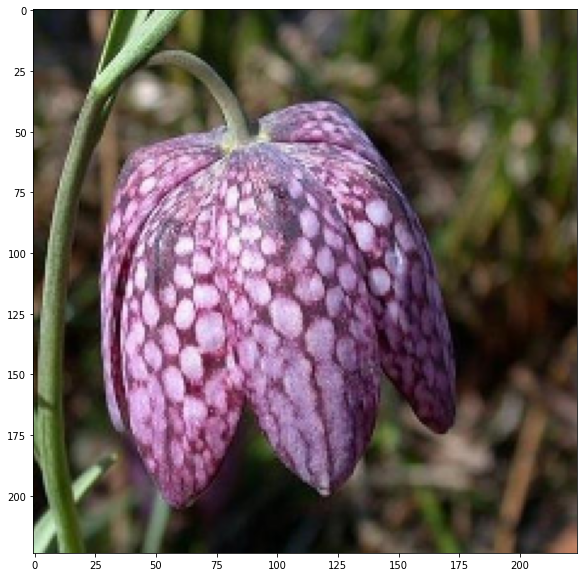

2


In [196]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[22], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_6.predict(X_test[22].reshape(1,224,224,3))))

# **Observations:**
  - Model predict the label as 2 which the flower species is actually Fritillary. Its a wrong prediction


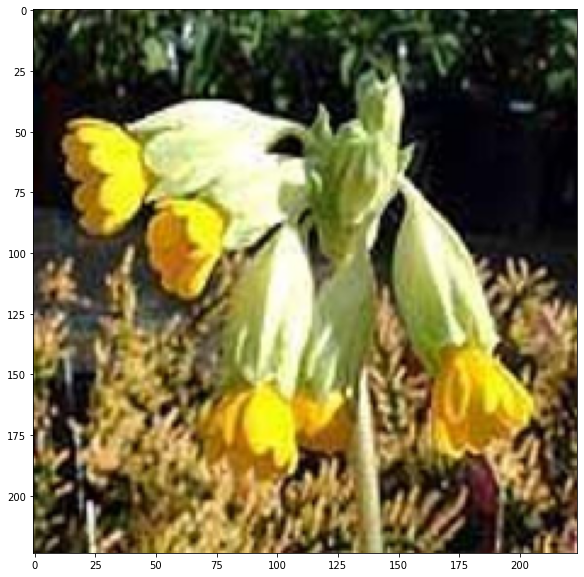

2


In [197]:
plt.figure(figsize=(20,10))
plt.imshow(cv2.cvtColor(X_test[11], cv2.COLOR_BGR2RGB))
plt.show()
print(np.argmax(model_6.predict(X_test[11].reshape(1,224,224,3))))

Observations:

- Model predict the label as 2 which the flower species is actually CowSlip. Its a wrong prediction


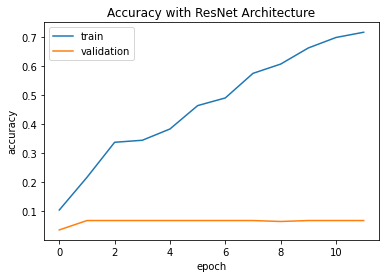

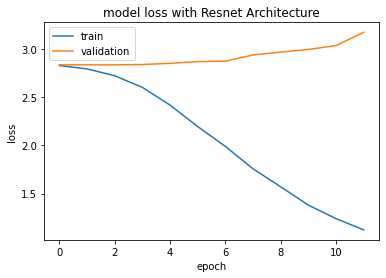

In [210]:
plt.plot(history_7.history['acc'])  
plt.plot(history_7.history['val_acc'])  
plt.title('Accuracy with ResNet Architecture')  
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()


plt.plot(history_7.history['loss'])  
plt.plot(history_7.history['val_loss'])  
plt.title('model loss with Resnet Architecture')  
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train','validation'],loc='upper left')
plt.show()

# **Observations:**
- Resnet 50 Architecture provide good accuracy in training but the Validation accuracy tends to be low due to lack of dataset. These deep layer architecture are providing the poor accuracy with less datasets.

- To get a better Validation and test Accuracy, we need a quite a high number of validation and test dataset.

- For the training dataset the loss looks to be gradually decreases as the number of epochs increases.

# **• Compare the results from the above 2 steps along with your detailed observations.**

- Observations from the own CNN architecture Designs: (model)
  - Firstly when I have created the CNN architecture as similar to VGG 16 layer, the training accuracy keeps low and the prediction is also bad, which makes the model_1 to be a underfit model.On the detailed analysis we have found the Dataset with minimal images caused the model to be underfit as when we go deep in CNN architecture the number of images should be more for better learning of the model.

- Observation from Own Desgined and tuned architecture.(model_2)
  - Latter I have tried with my own design and tuning by not following any of the traditional CNN architectures where I have kept low the fliters and once the images got flattern I ahve reduced the number of dense layers to improve the accuracy, Which have really helped to get a better training and testing accuracy eventhough we had a low number of images in the dataset. Model_2 shown as there is an exploding Gradient problem exists while there is a decrease in the loss.

- Observation from transfer Learning on VGG16: Model_3
 - Transfer Learning on VGG 16 by freezing the top 4 layers has given a good training accuracy and the test accuracy but seeing exploding Gradient issue. **Model_3 using VGG16 looks to be a good model.** 

- Observation from transfer Learning on VGG19: Model_4
 - Transfer Learning on VGG 19 by freezing the top 4 layers has given a good training accuracy and the test accuracy but seeing exploding Gradient issue. **Model_4 using VGG19 looks to be a good model and my favourite to use in production.**

- Observation from transfer Learning on Google Inception Net: Model_5
 -  Here we have tried the model with image augmentaion and we have found there is a slight increase in the training accuracy but the validation and Test accuracy looks to be low, the main reason is the data sets is minimal for test and validation. Exploding Gradeint issue occurs only in the validation dataset but in the training set has a smooth decrease in loss as the epochs increases. **Model_5 looks to be an underfit model.**

- Observation from transfer Learning on ResNet: Model_6
 - As we have a less number of dataset,on applying deep layer convolution architectures makes the model to be under fit. Here Resnet50 makes the model to be underfit as there are small number of validation and test dataset. Resnet addresses the Exploding gradient problem but due to small data size results in Vanishing gradient.**Model_6 is an underfit Model.**


# **5. Explain in depth your strategy to maintain and support the AIML image classifier after it in production.**

**Actions 1:  Monitoring the Metrics of productionized Model**
  Keep an eye on the below metrics of the productionized Model.
   - Type 1 Error
   - Type 2 Error
   - Accuracy
   - Precision
   - Recall
   - F1 Score
   - MAE
   - MSE
   - R2
   
**Actions 2:  Monitoring the Prediction distribution of my model regularly**
      There should be a periodic check in the model predictions capability.To gain more granular insights into your model’s performance, it is essential to continuously evaluate your model on specific data slices, and examine per-class performance as well. If your model is customer-facing, you will want to ensure that your most loyal customers are having a good experience. Additionally, you could automatically identify slices with low performance in order to gain insight and improve your models


**Actions 3:  Adding Low Percentage of Negative Test Data.**

First, if possible add a low percentage of negative test data as part of model results. Negative testing is a method of testing an application that ensures that the model handles the unwanted input the way it should be

**Actions 4:  Retrain the model with new data.**

When the model produced high accuracy score and negative test accuracy is also significantly high, get the reconstruction error value from the AE model with recent data. If the reconstruction error value is low the data is not changed much. The next best action will be retraining the model with recent data.

**Actions 5:  Retrain the model with additional features/classess.**

When the model produced a low accuracy score on both positive and negative dataset accuracy is significantly high.  , the reconstruction error value is low that indicates that data is not changed much but we need to tune the model with new features/classess. In this case, you already have the data you need, but retraining the same model on the same data is not going to help. The action would be develop new features/classess by doing the feature-engineering step and retrain the model with additional features/classess. Remember to preserve the features/classess from the original model.

**Actions 6:  Develop a new model from scratch.**
          
When the model produced a low accuracy score on recent positive data and negative test accuracy is significantly high. Furthermore, the reconstruction error value is also high for recent input data is a clear indication that the new recent input data is much different and has new features than the model originally trained.  The next nest action would be repeating the process of feature extraction, then build, and train a new model from scratch.

**Actions 7:  Identifying the Pattern.**

Another important thing to note is that not every decrease in performance is an indication that your model is broken. Try to understand if your performance fluctuations follow a specific pattern (e.g. seasonality/response to financial crisis), and if you are able to identify such a pattern, you may be able to create a more robust model that will have better overall performance.

**Actions 8:  Monitor What Your Model Doesn’t Do.**

When there is a significant decrease in your model’s performance, it’s probably time to update it. But what if the model is still “okay”? In order to ensure we are getting the best performance we can, we recommend continuously comparing our production model’s performance with potential new candidates.

**Actions 9:  Detecting Data Integrity Issues.**

This is a fairly simple step you could take that will save you a lot of heartache. Essentially we want to validate that the schema of the data in production is identical to the development data schema and that it does not change with time. This includes checking the consistency of feature names and data types, detecting new possible values for categorical data or new textual values, identifying missing values, and more.


**Actions 10:  Automated Retraining.**

Once you’ve deployed a steady ML model, and you’ve gone through the process of retraining your model and deploying it again, it’s time to automate the process. In some scenarios, where data changes are very swift it could be worth trying a more risky online learning approach. In this approach, your model is updated whenever new examples are available.


